## COVID19 Global Forecasting
### Data Analysis

#### Import Data + Data Understanding

#### first of all we import the covid_19 data and we prepare the packages that we are going to use later

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
import pycountry
import os
import numpy as np 
import pandas as pd 
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

In [4]:
# import train data and understand the data
df_train=pd.read_csv("train.csv")
df_train.head()

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
0,1,NaN,Afghanistan,2020-01-22,0.0,0.0
1,2,NaN,Afghanistan,2020-01-23,0.0,0.0
2,3,NaN,Afghanistan,2020-01-24,0.0,0.0
3,4,NaN,Afghanistan,2020-01-25,0.0,0.0
4,5,NaN,Afghanistan,2020-01-26,0.0,0.0


In [5]:
df_train.sample(6)

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
11101,11200,NaN,Denmark,2020-02-18,0.0,0.0
2974,3001,NaN,Bhutan,2020-02-27,0.0,0.0
14864,14996,NaN,Guatemala,2020-03-23,20.0,1.0
23162,23367,NaN,Russia,2020-05-11,221344.0,2009.0
1684,1699,Victoria,Australia,2020-05-03,1406.0,18.0
33068,33361,NaN,Ukraine,2020-04-03,1072.0,27.0


In [6]:
# Number of rows and columns
df_train.shape

(35369, 6)

In [7]:
# Columns names
df_train.columns

Index(['Id', 'Province_State', 'Country_Region', 'Date', 'ConfirmedCases',
       'Fatalities'],
      dtype='object')

In [8]:
# Type of columns
df_train.dtypes

Id                  int64
Province_State     object
Country_Region     object
Date               object
ConfirmedCases    float64
Fatalities        float64
dtype: object

In [9]:
# Do the same thing on the test data
df_test=pd.read_csv("test.csv")
df_test.head()

,ForecastId,Province_State,Country_Region,Date
0,1,NaN,Afghanistan,2020-04-02
1,2,NaN,Afghanistan,2020-04-03
2,3,NaN,Afghanistan,2020-04-04
3,4,NaN,Afghanistan,2020-04-05
4,5,NaN,Afghanistan,2020-04-06


In [10]:
df_test.shape

(13459, 4)

In [11]:
df_test.columns

Index(['ForecastId', 'Province_State', 'Country_Region', 'Date'], dtype='object')

In [12]:
# Names of the countries
df_train["Country_Region"].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan',
       'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'Brunei', 'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi',
       'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica',
       "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Diamond Princess', 'Djibouti', 'Dominica', 'Dominican Republic',
       'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea',
       'Estonia', 'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France',
       'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece',
       'Grenada', 'Guatemala', 'Guinea', 'Guine

In [13]:
len(df_train["Country_Region"].unique())

184

In [14]:
df_train["Country_Region"].value_counts()

US                     6102
China                  3729
Canada                 1356
France                 1243
United Kingdom         1243
                       ... 
Bahrain                 113
Pakistan                113
Taiwan*                 113
Trinidad and Tobago     113
Saudi Arabia            113
Name: Country_Region, Length: 184, dtype: int64

#### From the first interaction with the data, we can affirm that it includes 184 countries for the past 113 days. We can note that there are some countries that have more precise visualization for each State such as US and France.

## Explory Data Analysis 

### In this section, we attempted to split our axes of analysis to two big parts which are: Confirmed cases and Fatalities Cases. 
### This strategy led us to revail the number of Susceptible,Infected and Deceased  people all around the world.

### Confirmed Cases Covid-19 by country

In [58]:
df = df_train[df_train['Date']=="2020-05-13"].fillna('NA').groupby(['Country_Region','Province_State','Date'])['ConfirmedCases'].sum().groupby(['Country_Region','Province_State']).max().sort_values().groupby(['Country_Region']).sum().sort_values(ascending=False)
top_conf_count = pd.DataFrame(df)
top_conf_count=top_conf_count.reset_index()

fig_reg = px.bar(top_conf_count.head(20), x='Country_Region', y='ConfirmedCases')

fig_reg.show()

In [47]:
df = df_train.fillna('NA').groupby(['Country_Region','Province_State','Date'])['ConfirmedCases'].sum().groupby(['Country_Region','Province_State']).max().sort_values().groupby(['Country_Region']).sum().sort_values(ascending=False)
top_conf_count = pd.DataFrame(df)
top_conf_count1 = pd.DataFrame(df.head(10))
fig_reg = px.bar(top_conf_count1,x=top_conf_count1.index, y='ConfirmedCases',color='ConfirmedCases')
fig_reg.update_layout(
    title="Confirmed Cases by Country",
    xaxis_title=" Countries",
    yaxis_title="numbre of Confirmed Cases ",
    )
fig_reg.show()

In [17]:
top_conf_count.head(10)

,ConfirmedCases
Country_Region,
US,1390235.0
Russia,242271.0
United Kingdom,230986.0
Spain,228691.0
Italy,222104.0
Brazil,190137.0
France,178410.0
Germany,174098.0
Turkey,143114.0


### From the last graphs and visualisation, we can say that US and the European continent are the most  affected countries by Covid-19. Even Though, China was the first country got the virus, it holds the rank 11 by the number of confirmed cases .

### Fatalities Cases Covid-19 by country

In [18]:
df_d = df_train.fillna('NA').groupby(['Country_Region','Province_State','Date'])['Fatalities'].sum().groupby(['Country_Region','Province_State']).max().sort_values().groupby(['Country_Region']).sum().sort_values(ascending=False)
top_death_count = pd.DataFrame(df_d)
top_death_count

,Fatalities
Country_Region,
US,84115.0
United Kingdom,33264.0
Italy,31106.0
Spain,27104.0
France,27077.0
...,...
Holy See,0.0
Mozambique,0.0
Cambodia,0.0


In [19]:
top_death_count1 = pd.DataFrame(df_d.head(10))
fig_reg_fat = px.bar(top_death_count1,x=top_death_count1.index, y='Fatalities',color='Fatalities')
fig_reg_fat.update_layout(
    title="Fatalities by Country",
    xaxis_title=" Countries",
    yaxis_title="numbre of Fatalities ",
    )
fig_reg_fat.show()

In [20]:
# Ordrening the countries by number of fatalities
top_count = pd.concat([top_conf_count , top_death_count],axis=1)
top_count = top_count.sort_values(['ConfirmedCases'],ascending=False)[:10]
top_count

,ConfirmedCases,Fatalities
US,1390235.0,84115.0
Russia,242271.0,2212.0
United Kingdom,230986.0,33264.0
Spain,228691.0,27104.0
Italy,222104.0,31106.0
Brazil,190137.0,13240.0
France,178410.0,27077.0
Germany,174098.0,7861.0
Turkey,143114.0,3952.0
Iran,112725.0,6783.0


### Based on the previous graph, it can be seen that US has the highest deceased cases. We can also notice United Kingdon steeply took  the elevated rank in European countries .

### Confirmed and Fatalities Cases Covid-19 by country

In [21]:
import plotly.graph_objects as go
fig = go.Figure(data=[
    go.Bar(name='ConfirmedCases',x=top_count.index, y=top_count['ConfirmedCases']),
    go.Bar(name='Fatalities',x=top_count.index, y=top_count['Fatalities'])
])
# Change the bar mode
fig.update_layout(barmode='group',title="Confirmed Cases and Fatalities by Country",
    xaxis_title=" Countries",
    yaxis_title="number of Confirmed Cases and Fatalities ",)
fig.show()

In [ ]:
temp_df = df_train.loc[df_train["Date"]=="2020-05-13"].groupby(['Country_Region'])["ConfirmedCases","Fatalities"].sum().reset_index()

temp=temp_df.sort_values(by="ConfirmedCases",ascending=True)
fig = go.Figure(data=[go.Pie(labels=temp["Country_Region"], values=temp["ConfirmedCases"],hole=0.1)])
fig.show()

#### The pie Chart illustrates the percentage as well as the number of confirmed cases for each coutry. It's totally clear that the US takes the lead with 32% of total confrmed cases compared to Tunisia which has a slightly weak value 0.02%.

### As seen on the previous visualization, we tried to combine both confirmed and fatalities in order to illustrate better the obvious cases which conducts us to observe more details about the pandemic spread in chosen coutries.

### Analyse particular countries' cases

## Exploring Tunisia's spread case

In [22]:
# Visualize tunisia dataframe
df_train[df_train["Country_Region"]=="Tunisia"]

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
26555,26791,NaN,Tunisia,2020-01-22,0.0,0.0
26556,26792,NaN,Tunisia,2020-01-23,0.0,0.0
26557,26793,NaN,Tunisia,2020-01-24,0.0,0.0
26558,26794,NaN,Tunisia,2020-01-25,0.0,0.0
26559,26795,NaN,Tunisia,2020-01-26,0.0,0.0
...,...,...,...,...,...,...
26663,26899,NaN,Tunisia,2020-05-09,1032.0,45.0
26664,26900,NaN,Tunisia,2020-05-10,1032.0,45.0
26665,26901,NaN,Tunisia,2020-05-11,1032.0,45.0
26666,26902,NaN,Tunisia,2020-05-12,1032.0,45.0


In [23]:
fig_tun_fatal = px.line(df_train[df_train["Country_Region"]=="Tunisia"], x="Date", y="Fatalities", title='Tunisia Covid-19 Fatalities')
fig.update_layout(barmode='group',
    xaxis_title=" Date ",
    yaxis_title=" Fatalities ",)
fig_tun_fatal.show()

### The line graph shows the evolution of fatalities cases starting from 22 January 2020 until now. The figure is given the number of deceased  cases by correspondent date.
### - Tunisia confirmed the first death on March the 19th and increased minimally with a margin of 2 to 4 cases per day.


In [24]:
fig_tun_confirmed = px.line(df_train[df_train["Country_Region"]=="Tunisia"], x="Date", y="ConfirmedCases", title='Tunisia Covid-19 confirmed cases')
fig.update_layout(
    xaxis_title=" Date ",
    yaxis_title=" Confirmed Cases",)
fig_tun_confirmed.show()

### The line graph shows the evolution of confirmed cases starting from 22 January 2020 until now. The figure is given the number of confirmed cases by correspondent date.

### - The first case appeared on March the 4th and maintened stable until March the 7th.
### - We can see that the number of confirmed cases increased slightly from March the 8th to March the 30th with a margin of approximately 15 confirmed cases per day.
### - On March the 31th , the number grew to reach 394 cases to maintain a stable average increase (20-30 per day)  until April the 27th.
### - The last wave shows an obvious decrease on the average value(less than 10 per day) .



In [25]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="Tunisia"]["ConfirmedCases"],
    x=df_train[df_train["Country_Region"]=="Tunisia"]["Date"],
    name = 'ConfirmedCases', 
    connectgaps=True 
))
fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="Tunisia"]["Fatalities"],
    x=df_train[df_train["Country_Region"]=="Tunisia"]["Date"],
    name='Fatalities',
))
fig.update_layout(title=' ConfirmedCases & Fatalities Covid-19 in Tunisia', xaxis_title=" Date ",yaxis_title=" Confirmed Cases & Fatalities",)
fig.show()

### We can confirm by combinig between confirmed and fatalities cases that the number of deceased cases(45 cases) is too low compared to the infected cases(1032 cases).

## Exploring United States' spread case

In [26]:
df_train[df_train["Country_Region"]=="US"]

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
26781,27019,Alabama,US,2020-01-22,0.0,0.0
26782,27020,Alabama,US,2020-01-23,0.0,0.0
26783,27021,Alabama,US,2020-01-24,0.0,0.0
26784,27022,Alabama,US,2020-01-25,0.0,0.0
26785,27023,Alabama,US,2020-01-26,0.0,0.0
...,...,...,...,...,...,...
32878,33169,Wyoming,US,2020-05-09,653.0,7.0
32879,33170,Wyoming,US,2020-05-10,662.0,7.0
32880,33171,Wyoming,US,2020-05-11,669.0,7.0
32881,33172,Wyoming,US,2020-05-12,675.0,7.0


In [27]:
sort=df_train[df_train["Country_Region"]=="US"].sort_values(by=["ConfirmedCases"],ascending=False)[:400]
sort_fat=df_train[df_train["Country_Region"]=="US"].sort_values(by=["Fatalities"],ascending=False)[:400]

In [28]:
fig = px.line(sort, x="Date", y="ConfirmedCases",color='Province_State', title='US confirmed cases by state')
fig.update_layout( xaxis_title=" Date ",yaxis_title=" Confirmed Cases",)

fig.show()

### The line graph shows the evolution of confirmed cases starting from 24 March 2020 until now. The figure is given the number of confirmed cases by correspondent date and Province State.
### -Overall the graph shows a huge increase in US especially in New York city.
### -The other states are risen steadily compared to New York.



In [29]:
fig_fat = px.line(sort_fat, x="Date", y="Fatalities",color='Province_State', title='US Fatalities cases by state')
fig.update_layout(xaxis_title=" Date ",yaxis_title="Fatalities",)
fig_fat.show()

### The line graph shows the evolution of fatalities cases starting from 29 March 2020 until now. The figure is given the number of deceased  cases by correspondent date and Province Sate.
### -Overall the graph shows a dramatically rise  in US especially in New York city.
### -The other states are grown steadily compared to New York.



In [30]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="US"].fillna('NA').groupby(['Date'])["ConfirmedCases"].sum(),
    x=df_train[df_train["Country_Region"]=="US"]["Date"],
    name = 'ConfirmedCases', 
    connectgaps=True 
))
fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="US"].fillna('NA').groupby(['Date'])['Fatalities'].sum(),
    x=df_train[df_train["Country_Region"]=="US"]["Date"],
    name='Fatalities',
))
fig.update_layout(title=' ConfirmedCases & Fatalities in USA')
fig.show()

### We can confirm by combinig between confirmed and fatalities cases that the number of deceased cases(1.390235 M cases) is too low compared to the infected cases(84.114 K cases).

## Brief Overview on non-mentioned countries:
### - Countries with increased confirmed cases
#### -Russia  illustrates a huge rise started from April the 5th with 5389 cases until now.
#### -Spain illustrates a huge rise started from March the 15th with 7798 until now.



### - Countries with Stable confirmed cases
#### - China shows a stable case starting from March the 20th with a number of 83.975 K until the present moment.
#### - Australia shows a stable case starting from April the 27th with a number of 15.274 K until the present moment.

## Exploring  Italy Case's spread case

In [31]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="Italy"]["ConfirmedCases"],
    x=df_train[df_train["Country_Region"]=="Italy"]["Date"],
    name = 'ConfirmedCases', 
    connectgaps=True
))
fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="Italy"]["Fatalities"],
    x=df_train[df_train["Country_Region"]=="Italy"]["Date"],
    name='Fatalities',
))
fig.update_layout(title=' ConfirmedCases & Fatalities in Italy')
fig.show()

## Exploring  France Case's spread case

In [32]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="France"].fillna('NA').groupby(['Date'])["ConfirmedCases"].sum(),
    x=df_train[df_train["Country_Region"]=="France"]["Date"],
    name = 'ConfirmedCases', 
    connectgaps=True 
))
fig.add_trace(go.Scatter(
    y=df_train[df_train["Country_Region"]=="France"].fillna('NA').groupby(['Date'])['Fatalities'].sum(),
    x=df_train[df_train["Country_Region"]=="France"]["Date"],
    name='Fatalities',
))
fig.update_layout(title=' ConfirmedCases & Fatalities in France')
fig.show()

In [45]:
country_df = df_train.groupby(['Date', 'Country_Region'])[['ConfirmedCases', 'Fatalities']].sum().reset_index()
country_df.tail()

,Date,Country_Region,ConfirmedCases,Fatalities
20787,2020-05-13,Vietnam,288.0,0.0
20788,2020-05-13,West Bank and Gaza,375.0,2.0
20789,2020-05-13,Western Sahara,6.0,0.0
20790,2020-05-13,Zambia,446.0,7.0
20791,2020-05-13,Zimbabwe,37.0,4.0


In [34]:
data = (
    df_train.groupby(["Country_Region","Date"])
    .agg({"ConfirmedCases": "sum", "Fatalities": "sum"})
    .reset_index()
)
test_data = (
    df_test.groupby(["Date", "Country_Region"])
    .last()
    .reset_index()[["Date", "Country_Region"]]
)

In [35]:
data["Date"] = pd.to_datetime(data.Date)
test_data["Date"] = pd.to_datetime(test_data.Date)

In [36]:
countries = data["Country_Region"].unique()
test_countries = test_data["Country_Region"].unique()

In [37]:
df_train1 = df_train.fillna('NA').groupby(['Country_Region','Date']).sum()
df_train1
df_train1.reset_index(inplace=True)
df_train1

,Country_Region,Date,Id,ConfirmedCases,Fatalities
0,Afghanistan,2020-01-22,1,0.0,0.0
1,Afghanistan,2020-01-23,2,0.0,0.0
2,Afghanistan,2020-01-24,3,0.0,0.0
3,Afghanistan,2020-01-25,4,0.0,0.0
4,Afghanistan,2020-01-26,5,0.0,0.0
...,...,...,...,...,...
20787,Zimbabwe,2020-05-09,35677,35.0,4.0
20788,Zimbabwe,2020-05-10,35678,36.0,4.0
20789,Zimbabwe,2020-05-11,35679,36.0,4.0
20790,Zimbabwe,2020-05-12,35680,36.0,4.0


In [38]:
import plotly.graph_objects as go

from plotly.offline import iplot


for i in range(1, len(countries)):
  
    _data = df_train1[df_train1["Country_Region"] == countries[i - 1]]
    trace1 = go.Scatter(
        x=_data.Date,
        y=_data.ConfirmedCases,
        name= "Confirmed Cases"
    )
    trace2 = go.Scatter(
        x=_data.Date,
        y=_data.Fatalities,
        name="Confirmed Fatalities"
        )
    data1 = [trace1, trace2]
    layout = go.Layout(title = countries[i - 1], xaxis = {'title':'Date'}, yaxis = {'title':'value'})
    fig = go.Figure(data=data1,layout=layout)
    iplot(fig)

In [106]:
last_date = df_train.Date.max()
df_countries = df_train[df_train['Date']==last_date]
df_countries = df_countries.groupby('Country_Region', as_index=False)['ConfirmedCases','Fatalities'].sum()
df_countries = df_countries.nlargest(10,'ConfirmedCases')

#Get the trend for top 10 countries
df_trend = df_train.groupby(['Date','Country_Region'], as_index=False)['ConfirmedCases','Fatalities'].sum()
df_trend = df_trend.merge(df_countries, on='Country_Region')
df_trend.drop(['ConfirmedCases_y','Fatalities_y'],axis=1, inplace=True)
df_trend.rename(columns={'Country_Region':'Country', 'ConfirmedCases_x':'Cases', 'Fatalities_x':'Deaths'}, inplace=True)

#Add columns for studying logarithmic trends
df_trend['ln(Cases)'] = np.log(df_trend['Cases']+1)# Added 1 to remove error due to log(0).
df_trend['ln(Deaths)'] = np.log(df_trend['Deaths']+1)

In [107]:
px.line(df_trend, x='Date', y='Cases', color='Country', title='COVID19 Cases growth for top 10 worst affected countries')

In [108]:
px.line(df_trend, x='Date', y='Deaths', color='Country', title='COVID19 Deaths growth for top 10 worst affected countries')

In [109]:
px.line(df_trend, x='Date', y='ln(Cases)', color='Country', title='COVID19 Cases growth for top 10 worst affected countries(Logarithmic Scale)')

In [110]:
px.line(df_trend, x='Date', y='ln(Deaths)', color='Country', title='COVID19 Deaths growth for top 10 worst affected countries(Logarithmic Scale)')

In [113]:
df_map = df_train.copy()
df_map['Date'] = df_map['Date'].astype(str)
df_map = df_map.groupby(['Date','Country_Region'], as_index=False)['ConfirmedCases','Fatalities'].sum()

In [117]:
def get_iso3_util(country_name):
    try:
        country = pycountry.countries.get(name=country_name)
        return country.alpha_3
    except:
        if 'Congo' in country_name:
            country_name = 'Congo'
        elif country_name == 'Diamond Princess' or country_name == 'Laos' or country_name == 'MS Zaandam':
            return country_name
        elif country_name == 'Korea, South':
            country_name = 'Korea, Republic of'
        elif country_name == 'Taiwan*':
            country_name = 'Taiwan'
        elif country_name == 'Burma':
            country_name = 'Myanmar'
        elif country_name == 'West Bank and Gaza':
            country_name = 'Gaza'
        country = pycountry.countries.search_fuzzy(country_name)
        return country[0].alpha_3

d = {}
def get_iso3(country):
    if country in d:
        return d[country]
    else:
        d[country] = get_iso3_util(country)
    
df_map['iso_alpha'] = df_map.apply(lambda x: get_iso3(x['Country_Region']), axis=1)

In [118]:
df_map['ln(ConfirmedCases)'] = np.log(df_map.ConfirmedCases + 1)
df_map['ln(Fatalities)'] = np.log(df_map.Fatalities + 1)

In [122]:
px.choropleth(df_map, 
              locations="iso_alpha", 
              color="ln(ConfirmedCases)", 
              hover_name="Country_Region", 
              hover_data=["ConfirmedCases"] ,
              animation_frame="Date",
              color_continuous_scale=px.colors.sequential.dense, 
              title='Confirmed Cases growth(Logarithmic Scale)')

In [119]:
df_map['Mortality Rate%'] = round((df_map.Fatalities/df_map.ConfirmedCases)*100,2)

In [39]:
country_df['Date'] = country_df['Date'].apply(str)

fig = px.scatter_geo(country_df, locations="Country_Region", locationmode='country names', 
                     color="ConfirmedCases", size='ConfirmedCases', hover_name="Country_Region",
                     hover_data=['ConfirmedCases', 'Fatalities'],
                     range_color= [0, top_count['ConfirmedCases'].max()], 
                     projection="natural earth", animation_frame="Date", 
                     title='COVID-19: Confirmed cases spread Over Time', color_continuous_scale="portland" , size_max=80)
fig.show()

### The interactive map locates and tallies confirmed infections. Graphs detail virus progress over time.We can see the day and time of the most recent data update and data sources. 

In [123]:
px.choropleth(df_map, 
              locations="iso_alpha", 
              color="ln(Fatalities)", 
              hover_name="Country_Region",
              hover_data=["Fatalities"],
              animation_frame="Date",
              color_continuous_scale=px.colors.sequential.OrRd,
              title = 'Deaths growth(Logarithmic Scale)')

In [120]:
px.choropleth(df_map, 
                    locations="iso_alpha", 
                    color="Mortality Rate%", 
                    hover_name="Country_Region",
                    hover_data=["ConfirmedCases","Fatalities"],
                    animation_frame="Date",
                    color_continuous_scale=px.colors.sequential.Magma_r,
                    title = 'Worldwide Daily Variation of Mortality Rat')

### The interactive map locates and tallies confirmed fatalities. Graphs detail virus progress over time.We can see the day and time of the most recent data update and data sources. 

In [121]:
df_trend['Mortality Rate%'] = round((df_trend.Deaths/df_trend.Cases)*100,2)
px.line(df_trend, x='Date', y='Mortality Rate%', color='Country', title='Variation of Mortality Rate% \n(Top 10 worst affected countries)')

 ## Covid-19 spread over time

# **Ridge**

In [40]:
def getColumnInfo(df):
    #n_province =  df['Province_State'].nunique()
    n_country  =  df['Country_Region'].nunique()
    n_days     =  df['Date'].nunique()
    start_date =  df['Date'].unique()[0]
    end_date   =  df['Date'].unique()[-1]
    return  n_country, n_days, start_date, end_date

n_count_train, n_train_days, start_date_train, end_date_train = getColumnInfo(df_train1)
n_count_test,  n_test_days,  start_date_test,  end_date_test  = getColumnInfo(df_test)


df_test = df_test.loc[df_test.Date > '2020-04-10']
overlap_days = n_test_days - df_test.Date.nunique()


In [41]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures 
from sklearn.pipeline import make_pipeline
from tqdm import tqdm
import plotly.graph_objects as go
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline


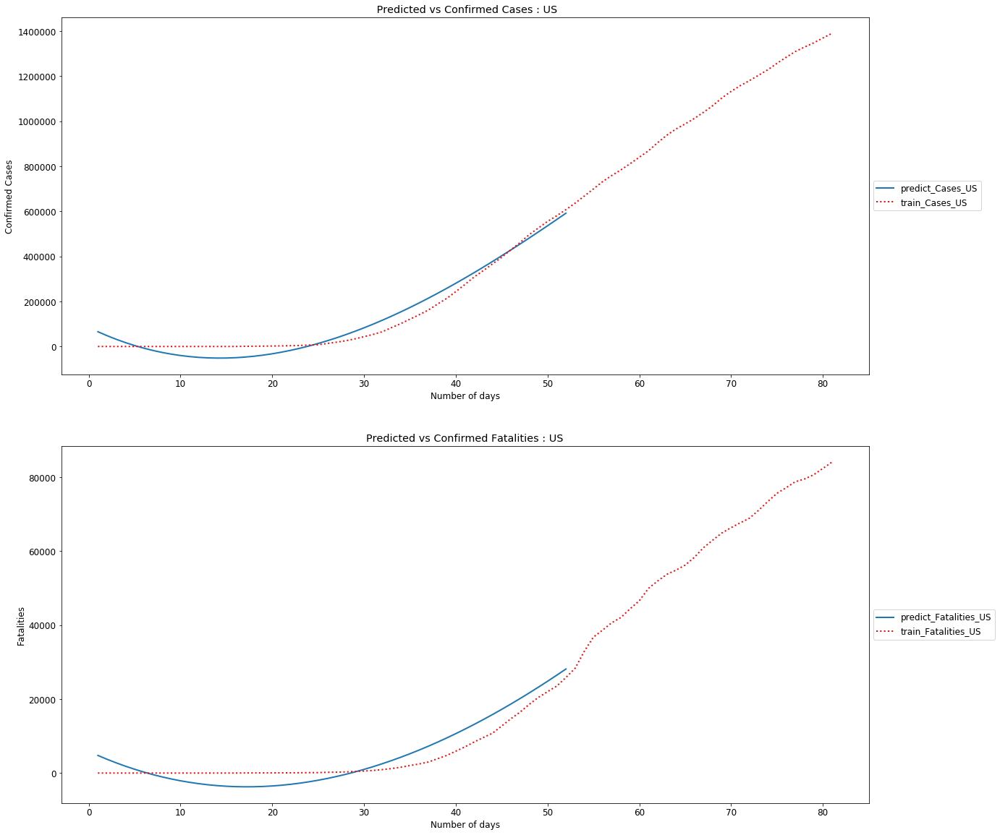

In [42]:
    countries_pred = 'US'

# Take the 1st day as 2020-02-23
    df = df_train1.loc[df_train1.Date >= '2020-02-23']
    n_days_europe = df.Date.nunique()

#for i in range(1, len(countries_pred)): 
    df_country_train = df_train1[df_train1['Country_Region']==countries_pred ]
    df_country_test = df_test[df_test['Country_Region']==countries_pred]  
    df_country_train = df_country_train.reset_index()[df_country_train.reset_index().Date > '2020-02-22']
    
    x_train = np.arange(1, n_days_europe+1).reshape((-1,1))
    x_test  = (np.arange(1,n_test_days+1+overlap_days)).reshape((-1,1)) 

# ****************** Fatalities ****************************
    y_train_f = df_country_train['Fatalities']
    model_f = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_f = model_f.fit(x_train, y_train_f)
    y_predict_f = model_f.predict(x_test) 

# ******************* Cases ******************************
    y_train_c = df_country_train['ConfirmedCases'] 
    model_c = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_c = model_c.fit(x_train, y_train_c)
    y_predict_c = model_c.predict(x_test)

# ***************** Figure **************************
    plt.rcParams.update({'font.size': 12})
    fig,(ax0,ax1) = plt.subplots(2,1,figsize=(20, 20))


    
    ax0.plot(x_test, y_predict_c,linewidth=2, label='predict_Cases_'+countries_pred)
    ax0.plot(x_train, y_train_c, linewidth=2, color='r', linestyle='dotted', label='train_Cases_'+countries_pred)
    ax0.set_title( " Predicted vs Confirmed Cases : " +countries_pred)
    ax0.set_xlabel("Number of days")
    ax0.set_ylabel("Confirmed Cases")
    ax0.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))
    
    ax1.plot(x_test, y_predict_f,linewidth=2, label='predict_Fatalities_'+countries_pred)
    ax1.plot(x_train, y_train_f, linewidth=2, color='r', linestyle='dotted', label='train_Fatalities_'+countries_pred)
    ax1.set_title("Predicted vs Confirmed Fatalities : " + countries_pred)
    ax1.set_xlabel("Number of days")
    ax1.set_ylabel("Fatalities")
    ax1.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))


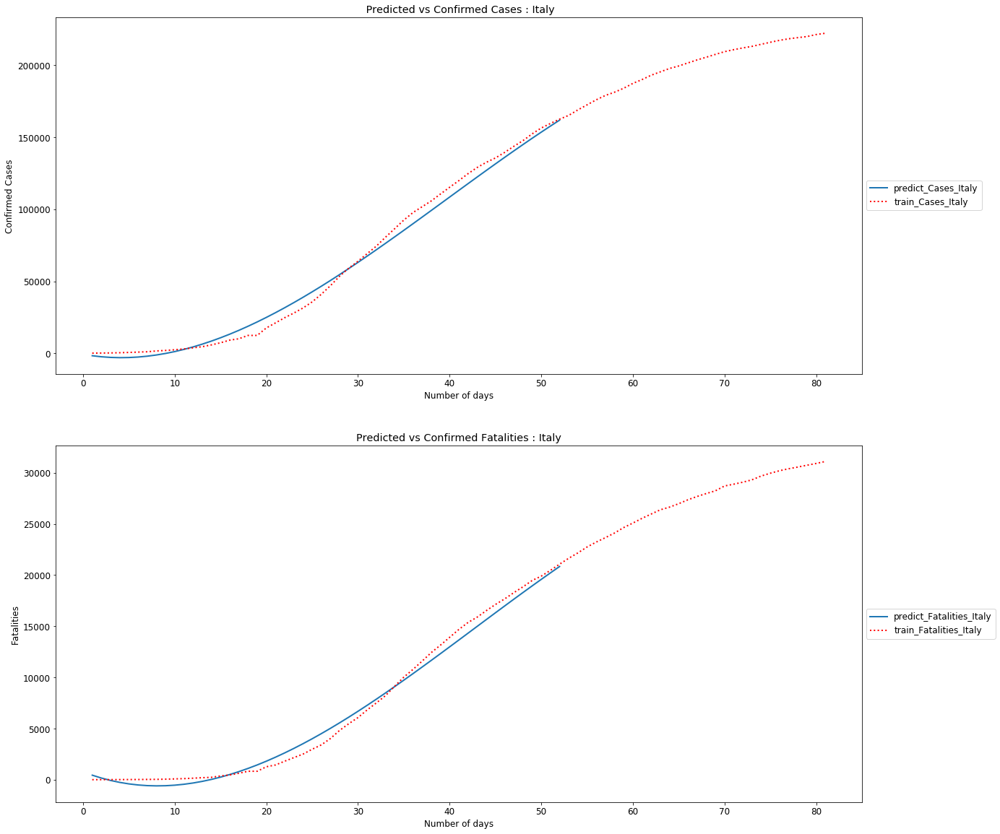

In [43]:
    countries_pred = 'Italy'

# Take the 1st day as 2020-02-23
    df = df_train1.loc[df_train1.Date >= '2020-02-23']
    n_days_europe = df.Date.nunique()

#for i in range(1, len(countries_pred)): 
    df_country_train = df_train1[df_train1['Country_Region']==countries_pred ]
    df_country_test = df_test[df_test['Country_Region']==countries_pred]  
    df_country_train = df_country_train.reset_index()[df_country_train.reset_index().Date > '2020-02-22']
    
    x_train = np.arange(1, n_days_europe+1).reshape((-1,1))
    x_test  = (np.arange(1,n_test_days+1+overlap_days)).reshape((-1,1)) 

# ****************** Fatalities ****************************
    y_train_f = df_country_train['Fatalities']
    model_f = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_f = model_f.fit(x_train, y_train_f)
    y_predict_f = model_f.predict(x_test) 

# ******************* Cases ******************************
    y_train_c = df_country_train['ConfirmedCases'] 
    model_c = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_c = model_c.fit(x_train, y_train_c)
    y_predict_c = model_c.predict(x_test)

# ***************** Figure **************************
    plt.rcParams.update({'font.size': 12})
    fig,(ax0,ax1) = plt.subplots(2,1,figsize=(20, 20))


    
    ax0.plot(x_test, y_predict_c,linewidth=2, label='predict_Cases_'+countries_pred)
    ax0.plot(x_train, y_train_c, linewidth=2, color='r', linestyle='dotted', label='train_Cases_'+countries_pred)
    ax0.set_title( " Predicted vs Confirmed Cases : " +countries_pred)
    ax0.set_xlabel("Number of days")
    ax0.set_ylabel("Confirmed Cases")
    ax0.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))
    
    ax1.plot(x_test, y_predict_f,linewidth=2, label='predict_Fatalities_'+countries_pred)
    ax1.plot(x_train, y_train_f, linewidth=2, color='r', linestyle='dotted', label='train_Fatalities_'+countries_pred)
    ax1.set_title("Predicted vs Confirmed Fatalities : " + countries_pred)
    ax1.set_xlabel("Number of days")
    ax1.set_ylabel("Fatalities")
    ax1.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))


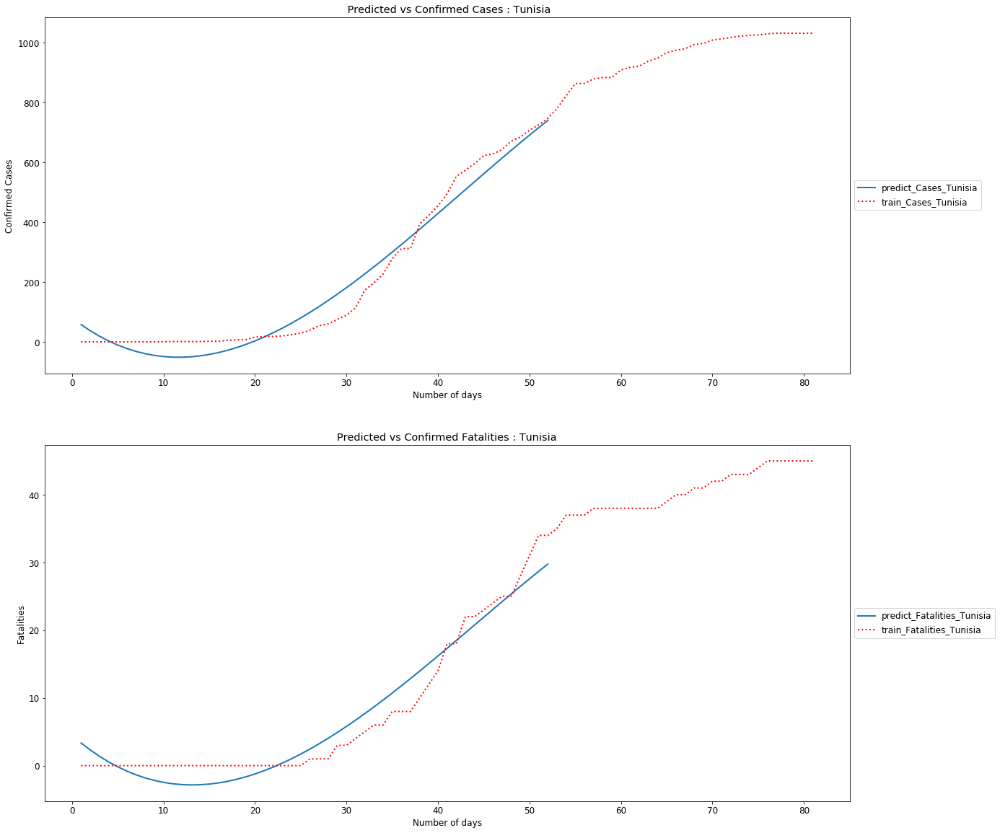

In [44]:
    countries_pred = 'Tunisia'

# Take the 1st day as 2020-02-23
    df = df_train1.loc[df_train1.Date >= '2020-02-23']
    n_days_europe = df.Date.nunique()

#for i in range(1, len(countries_pred)): 
    df_country_train = df_train1[df_train1['Country_Region']==countries_pred ]
    df_country_test = df_test[df_test['Country_Region']==countries_pred]  
    df_country_train = df_country_train.reset_index()[df_country_train.reset_index().Date > '2020-02-22']
    
    x_train = np.arange(1, n_days_europe+1).reshape((-1,1))
    x_test  = (np.arange(1,n_test_days+1+overlap_days)).reshape((-1,1)) 

# ****************** Fatalities ****************************
    y_train_f = df_country_train['Fatalities']
    model_f = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_f = model_f.fit(x_train, y_train_f)
    y_predict_f = model_f.predict(x_test) 

# ******************* Cases ******************************
    y_train_c = df_country_train['ConfirmedCases'] 
    model_c = make_pipeline(PolynomialFeatures(degree=3), Ridge(fit_intercept=False)) 
    model_c = model_c.fit(x_train, y_train_c)
    y_predict_c = model_c.predict(x_test)

# ***************** Figure **************************
    plt.rcParams.update({'font.size': 12})
    fig,(ax0,ax1) = plt.subplots(2,1,figsize=(20, 20))


    
    ax0.plot(x_test, y_predict_c,linewidth=2, label='predict_Cases_'+countries_pred)
    ax0.plot(x_train, y_train_c, linewidth=2, color='r', linestyle='dotted', label='train_Cases_'+countries_pred)
    ax0.set_title( " Predicted vs Confirmed Cases : " +countries_pred)
    ax0.set_xlabel("Number of days")
    ax0.set_ylabel("Confirmed Cases")
    ax0.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))
    
    ax1.plot(x_test, y_predict_f,linewidth=2, label='predict_Fatalities_'+countries_pred)
    ax1.plot(x_train, y_train_f, linewidth=2, color='r', linestyle='dotted', label='train_Fatalities_'+countries_pred)
    ax1.set_title("Predicted vs Confirmed Fatalities : " + countries_pred)
    ax1.set_xlabel("Number of days")
    ax1.set_ylabel("Fatalities")
    ax1.legend(loc='center left',bbox_to_anchor=(1.0, 0.5))
